# Data Overview

### Arrhythmia Dataset
- Number of Samples: 109446
- Number of Categories: 5
- Sampling Frequency: 125Hz
- Data Source: Physionet's MIT-BIH Arrhythmia Dataset
- Classes: ['N': 0, 'S': 1, 'V': 2, 'F': 3, 'Q': 4]

|Category|Annotations|
|--|--|
|N|1. Normal|
||2. Left/Right bundle branch block|
||3. Atrial escape|
||4. Nodal escape|
| | |
|S|1. Atrial premature|
||2. Aberrant atrial premature
||3. Nodal premature
||4. Supra-ventricular premature|
| | |
|V|1. Premature ventricular contraction|
||2. Ventricular escape|
|F|1. Fusion of ventricular and normal|
| | |
|Q|1. Paced|
||2. Fusion of paced and normal|
||3. Unclassifiable|

# Import Libraries

In [67]:
# Data manipulation and analysis
import pandas as pd
import numpy as np

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px  # If you plan to use interactive plots

# Deep Learning (PyTorch)
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
from torch.nn.utils import weight_norm

# Data preprocessing and model selection
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, auc, log_loss, precision_recall_curve, roc_curve
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.preprocessing import label_binarize

# Model evaluation
from sklearn.metrics import classification_report, confusion_matrix
from mlxtend.plotting import plot_confusion_matrix
from sklearn.ensemble import VotingClassifier

# Other utilities (if needed)
import warnings
warnings.filterwarnings("ignore")  # Use with caution! Suppresses warnings.

# For setting random seeds
import random

In [3]:
# Set Random Seeds (Crucial for Reproducibility)
torch.manual_seed(42)
np.random.seed(42)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

# Utility Functions

In [4]:
import matplotlib.pyplot as plt
import numpy as np

def learning_curves_plot(tr_data, start_epoch):
    # Extract data (adapt to your PyTorch training loop output)
    tacc = tr_data['train_acc']  # Replace 'train_acc' with your actual key
    tloss = tr_data['train_loss'] # Replace 'train_loss' with your actual key
    vacc = tr_data['val_acc']    # Replace 'val_acc' with your actual key
    vloss = tr_data['val_loss']   # Replace 'val_loss' with your actual key


    Epoch_count = len(tacc) + start_epoch
    Epochs = list(range(start_epoch + 1, Epoch_count + 1)) # More concise way to generate epoch numbers

    index_loss = np.argmin(vloss)
    val_lowest = vloss[index_loss]
    index_acc = np.argmax(vacc)
    acc_highest = vacc[index_acc]

    plt.style.use('fivethirtyeight')

    sc_label = 'best epoch= ' + str(index_loss + 1 + start_epoch)
    vc_label = 'best epoch= ' + str(index_acc + 1 + start_epoch)

    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 8))

    axes[0].plot(Epochs, tloss, 'r', label='Training loss')
    axes[0].plot(Epochs, vloss, 'g', label='Validation loss')
    axes[0].scatter(Epochs[index_loss], val_lowest, s=150, c='blue', label=sc_label) # Use Epochs[index_loss]
    axes[0].set_title('Training and Validation Loss')
    axes[0].set_xlabel('Epochs')
    axes[0].set_ylabel('Loss')
    axes[0].legend()

    axes[1].plot(Epochs, tacc, 'r', label='Training Accuracy')
    axes[1].plot(Epochs, vacc, 'g', label='Validation Accuracy')
    axes[1].scatter(Epochs[index_acc], acc_highest, s=150, c='blue', label=vc_label) # Use Epochs[index_acc]
    axes[1].set_title('Training and Validation Accuracy')
    axes[1].set_xlabel('Epochs')
    axes[1].set_ylabel('Accuracy')
    axes[1].legend()

    plt.tight_layout()
    plt.show()

# Load & Explore Data

In [5]:
# Load dataset
train_data = pd.read_csv('D:\CSE\MP-akash\mitbih_train.csv')
test_data = pd.read_csv('D:\CSE\MP-akash\mitbih_test.csv')

In [6]:
data = {'Feature': ['Number of Samples', 'Missing Values', 'Duplicated Values'],
        'Train Data': [train_data.shape[0], train_data.isna().sum().sum(), train_data.duplicated().sum()],
        'Test Data': [test_data.shape[0], test_data.isna().sum().sum(), test_data.duplicated().sum()]}

df = pd.DataFrame(data)
df

,Feature,Train Data,Test Data
0,Number of Samples,87553,21891
1,Missing Values,0,0
2,Duplicated Values,0,0


In [7]:
# Explore the dataset
train_data.head()

,9.779411554336547852e-01,9.264705777168273926e-01,6.813725233078002930e-01,2.450980395078659058e-01,1.544117629528045654e-01,1.911764740943908691e-01,1.519607901573181152e-01,8.578431606292724609e-02,5.882352963089942932e-02,4.901960864663124084e-02,...,0.000000000000000000e+00.79,0.000000000000000000e+00.80,0.000000000000000000e+00.81,0.000000000000000000e+00.82,0.000000000000000000e+00.83,0.000000000000000000e+00.84,0.000000000000000000e+00.85,0.000000000000000000e+00.86,0.000000000000000000e+00.87,0.000000000000000000e+00.88
0,0.960114,0.863248,0.461538,0.196581,0.094017,0.125356,0.099715,0.088319,0.074074,0.082621,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.000000,0.659459,0.186486,0.070270,0.070270,0.059459,0.056757,0.043243,0.054054,0.045946,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.925414,0.665746,0.541436,0.276243,0.196133,0.077348,0.071823,0.060773,0.066298,0.058011,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.967136,1.000000,0.830986,0.586854,0.356808,0.248826,0.145540,0.089202,0.117371,0.150235,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.927461,1.000000,0.626943,0.193437,0.094991,0.072539,0.043178,0.053541,0.093264,0.189983,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [8]:
print(train_data.iloc[:, -1].value_counts())  # Check class distribution in train data

0.000000000000000000e+00.88
0.0    72470
4.0     6431
2.0     5788
1.0     2223
3.0      641
Name: count, dtype: int64


In [9]:
print(test_data.iloc[:, -1].value_counts())  # Check class distribution in test data

0.000000000000000000e+00.65
0.0    18117
4.0     1608
2.0     1448
1.0      556
3.0      162
Name: count, dtype: int64


In [10]:
test_classes = test_data.iloc[:, -1].unique()
train_classes = train_data.iloc[:, -1].unique()

In [11]:
labels = {
    0: "Normal",
    1: "Artial Premature",
    2: "Premature ventricular contraction",
    3: "Fusion of ventricular and normal",
    4: "Fusion of paced and normal"
}

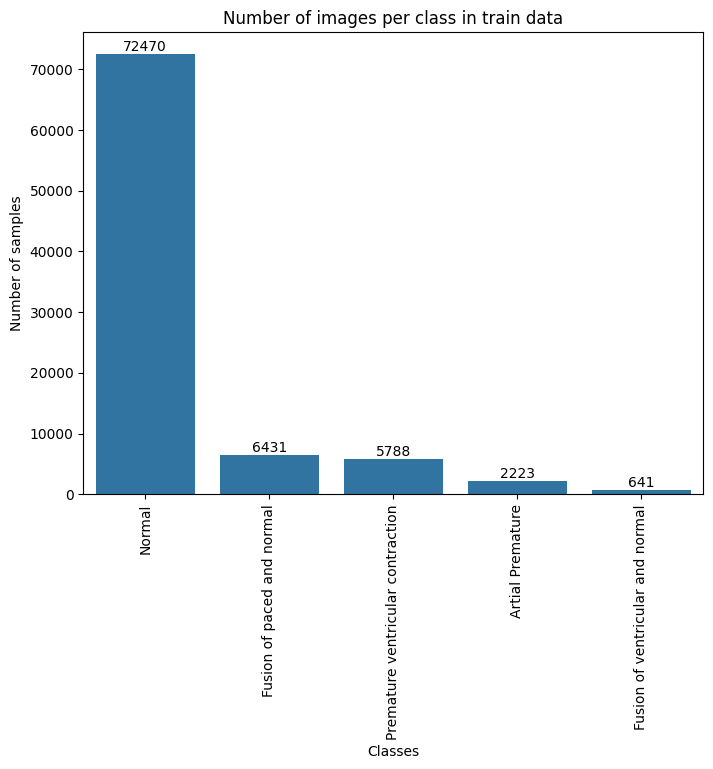

In [12]:
train_counts = train_data.iloc[:,-1].value_counts().rename(labels)

plt.figure(figsize=(8, 6))
ax = sns.barplot(x=train_counts.index, y=train_counts.values)

# Annotate each bar with the count
for i, p in enumerate(ax.patches):
    ax.annotate(f'{train_counts[i]}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='bottom', 
                fontsize=10)

plt.title('Number of images per class in train data')
plt.xlabel('Classes')
plt.ylabel('Number of samples')
plt.xticks(rotation=90)
plt.show()

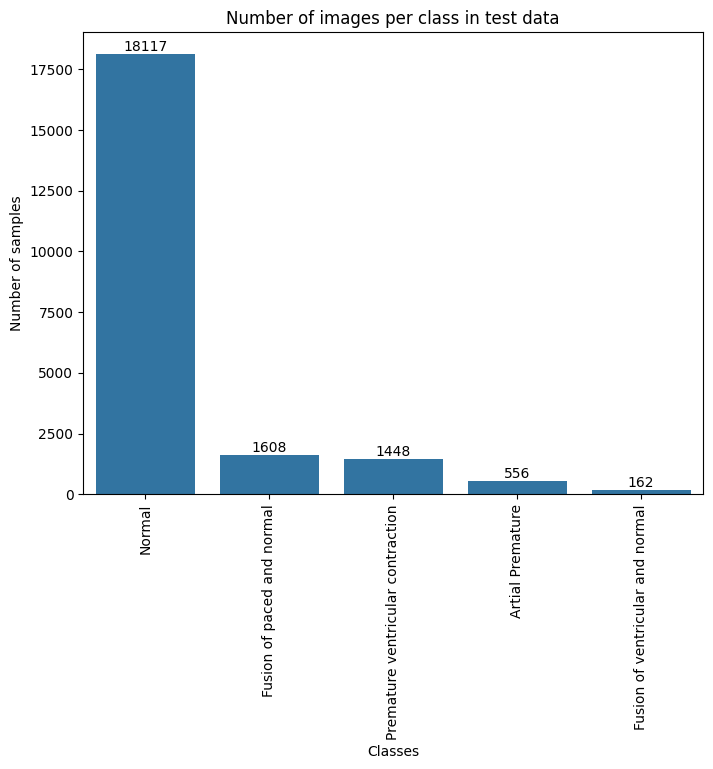

In [13]:
test_counts = test_data.iloc[:,-1].value_counts().rename(labels)

plt.figure(figsize=(8, 6))
ax = sns.barplot(x=test_counts.index, y=test_counts.values)

# Annotate each bar with the count
for i, p in enumerate(ax.patches):
    ax.annotate(f'{test_counts[i]}', 
                (p.get_x() + p.get_width() / 2., p.get_height()), 
                ha='center', va='bottom', 
                fontsize=10)

plt.title('Number of images per class in test data')
plt.xlabel('Classes')
plt.ylabel('Number of samples')
plt.xticks(rotation=90)
plt.show()

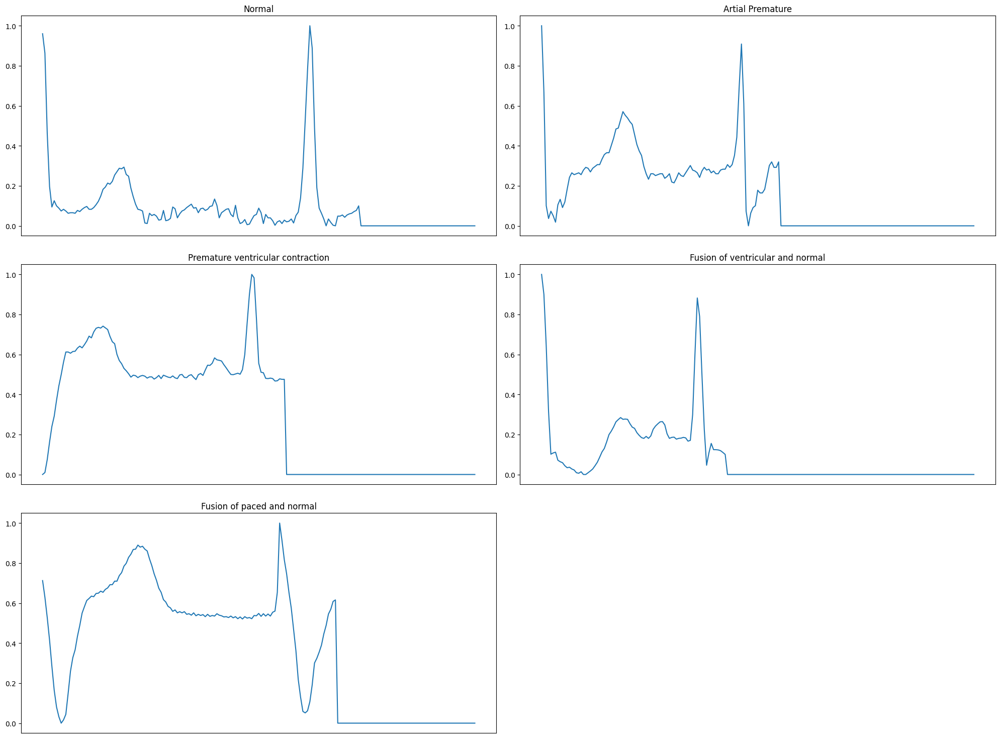

In [14]:
import matplotlib.pyplot as plt

train_classes = train_data.iloc[:, -1].unique()

plt.figure(figsize=(20, 15))

for i, cls in enumerate(train_classes):
    plt.subplot(3, 2, i + 1)
    class_data = train_data[train_data.iloc[:, -1] == cls].iloc[0, :-1]
    plt.plot(class_data)
    plt.title(f'{list(labels.values())[i]}')
    plt.xlabel(" ")

    # Correct way to remove x-axis ticks and labels:
    plt.xticks([])  # Or plt.gca().set_xticks([]) for more control
    # OR, if you want to *keep* the ticks but remove the *labels*:
    #plt.gca().set_xticklabels([])

plt.tight_layout()
plt.show()

# Data Preprocessing

In [15]:
X_train = train_data.iloc[:, :-1].values.astype(np.float32)
y_train = train_data.iloc[:, -1].values.astype(np.int64)
X_test = test_data.iloc[:, :-1].values.astype(np.float32)
y_test = test_data.iloc[:, -1].values.astype(np.int64)

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

X_train_scaled, X_val, y_train, y_val = train_test_split(
    X_train_scaled, y_train, test_size=0.2, random_state=42, stratify=y_train
)

X_train_scaled = X_train_scaled.reshape(X_train_scaled.shape[0], X_train_scaled.shape[1], 1)
X_val = X_val.reshape(X_val.shape[0], X_val.shape[1], 1)
X_test_scaled = X_test_scaled.reshape(X_test_scaled.shape[0], X_test_scaled.shape[1], 1)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

X_train_scaled = torch.tensor(X_train_scaled, dtype=torch.float32, device=device)
y_train = torch.tensor(y_train, dtype=torch.long, device=device)
X_val = torch.tensor(X_val, dtype=torch.float32, device=device)
y_val = torch.tensor(y_val, dtype=torch.long, device=device)
X_test_scaled = torch.tensor(X_test_scaled, dtype=torch.float32, device=device)
y_test = torch.tensor(y_test, dtype=torch.long, device=device)

# GPU Availability

In [16]:
# GPU availability
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("Using GPU:", torch.cuda.get_device_name(device))
    torch.cuda.manual_seed_all(42) # CUDA seed for all GPUs
else:
    device = torch.device("cpu")
    print("Using CPU")

Using GPU: NVIDIA GeForce GTX 1650 Ti


# GRU

In [17]:
# Define the GRU model in PyTorch
class GRUModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, num_classes, num_layers=2, dropout=0.2):  # Added num_layers and dropout
        super(GRUModel, self).__init__()
        self.gru = nn.GRU(input_dim, hidden_dim, num_layers=num_layers, batch_first=True, dropout=dropout) # batch_first added
        self.dropout = nn.Dropout(dropout)
        self.fc = nn.Linear(hidden_dim, num_classes)  # Output layer

    def forward(self, x):
        output, _ = self.gru(x)  # output: (batch_size, seq_len, hidden_dim)
        output = output[:, -1, :] # Get the last time step's output
        output = self.dropout(output)
        output = self.fc(output)
        return output

In [18]:
# Build the model
input_dim = X_train_scaled.shape[2]
hidden_dim = 64
num_classes = len(np.unique(y_train.cpu()))
gru_model = GRUModel(input_dim, hidden_dim, num_classes).to(device)


In [19]:
# Define the optimizer and loss function
optimizer = optim.Adam(gru_model.parameters(), lr=0.001)
loss_fn = nn.CrossEntropyLoss()

In [20]:
train_dataset = TensorDataset(X_train_scaled, y_train)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

val_dataset = TensorDataset(X_val, y_val)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

test_dataset = TensorDataset(X_test_scaled, y_test)  # Corrected line
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [21]:
# Training loop for GRU
num_epochs = 20

gru_results = {
    'train_loss': [],
    'train_acc': [],
    'val_loss': [],
    'val_acc': [],
    'test_loss': None,
    'test_acc': None
}

for epoch in range(num_epochs):
    train_loss_epoch = 0.0
    train_correct = 0
    train_total = 0
    gru_model.train()

    for X_batch, y_batch in train_loader:
        X_batch, y_batch = X_batch.to(device), y_batch.to(device)

        optimizer.zero_grad()
        y_pred = gru_model(X_batch)
        loss = loss_fn(y_pred, y_batch)
        loss.backward()
        optimizer.step()

        train_loss_epoch += loss.item()
        _, predicted = torch.max(y_pred, 1)
        train_total += y_batch.size(0)
        train_correct += (predicted == y_batch).sum().item()

    train_loss_epoch /= len(train_loader)
    train_acc_epoch = 100 * train_correct / train_total

    val_loss_epoch = 0.0
    val_correct = 0
    val_total = 0
    gru_model.eval()
    with torch.no_grad():
        for X_batch, y_batch in val_loader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            y_pred = gru_model(X_batch)
            loss = loss_fn(y_pred, y_batch)

            val_loss_epoch += loss.item()
            _, predicted = torch.max(y_pred, 1)
            val_total += y_batch.size(0)
            val_correct += (predicted == y_batch).sum().item()

    val_loss_epoch /= len(val_loader)
    val_acc_epoch = 100 * val_correct / val_total

    gru_results['train_loss'].append(train_loss_epoch)
    gru_results['train_acc'].append(train_acc_epoch)
    gru_results['val_loss'].append(val_loss_epoch)
    gru_results['val_acc'].append(val_acc_epoch)

    print(f"GRU Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss_epoch:.4f}, Train Acc: {train_acc_epoch:.2f}%, Val Loss: {val_loss_epoch:.4f}, Val Acc: {val_acc_epoch:.2f}%")

GRU Epoch 1/20, Train Loss: 0.4709, Train Acc: 87.42%, Val Loss: 0.3068, Val Acc: 92.19%
GRU Epoch 2/20, Train Loss: 0.2938, Train Acc: 92.29%, Val Loss: 0.2469, Val Acc: 93.55%
GRU Epoch 3/20, Train Loss: 0.2239, Train Acc: 94.06%, Val Loss: 0.1754, Val Acc: 95.56%
GRU Epoch 4/20, Train Loss: 0.1760, Train Acc: 95.40%, Val Loss: 0.1345, Val Acc: 96.56%
GRU Epoch 5/20, Train Loss: 0.1455, Train Acc: 96.19%, Val Loss: 0.1215, Val Acc: 96.76%
GRU Epoch 6/20, Train Loss: 0.1292, Train Acc: 96.57%, Val Loss: 0.1117, Val Acc: 97.13%
GRU Epoch 7/20, Train Loss: 0.1163, Train Acc: 96.95%, Val Loss: 0.0987, Val Acc: 97.33%
GRU Epoch 8/20, Train Loss: 0.1088, Train Acc: 97.14%, Val Loss: 0.0919, Val Acc: 97.56%
GRU Epoch 9/20, Train Loss: 0.1007, Train Acc: 97.34%, Val Loss: 0.0897, Val Acc: 97.73%
GRU Epoch 10/20, Train Loss: 0.0942, Train Acc: 97.44%, Val Loss: 0.0796, Val Acc: 97.73%
GRU Epoch 11/20, Train Loss: 0.0883, Train Acc: 97.55%, Val Loss: 0.0822, Val Acc: 97.72%
GRU Epoch 12/20, Tr

In [22]:
# Prediction and evaluation on test data for GRU
y_test_pred_gru = []
gru_model.eval()
with torch.no_grad():
    for X_batch, _ in test_loader:
        X_batch = X_batch.to(device)
        y_pred = gru_model(X_batch)
        _, predicted = torch.max(y_pred, 1)
        y_test_pred_gru.extend(predicted.tolist())

y_test_pred_gru = np.array(y_test_pred_gru)

test_loss = 0.0
test_correct = 0
test_total = 0
gru_model.eval()
with torch.no_grad():
    for X_batch, y_batch in test_loader:
        X_batch = X_batch.to(device)
        y_batch = y_batch.to(device)
        y_pred = gru_model(X_batch)
        loss = loss_fn(y_pred, y_batch)

        test_loss += loss.item()
        _, predicted = torch.max(y_pred.data, 1)
        test_total += y_batch.size(0)
        test_correct += (predicted == y_batch).sum().item()
test_loss /= len(test_loader)
test_acc = 100 * test_correct / test_total

gru_results['test_loss'] = test_loss
gru_results['test_acc'] = test_acc

In [23]:
# Table of Evaluation
gru_df_results = pd.DataFrame({
    'Set': ['Train', 'Validation', 'Test'],
    'Loss': [gru_results['train_loss'][-1], gru_results['val_loss'][-1], gru_results['test_loss']],
    'Accuracy': [gru_results['train_acc'][-1], gru_results['val_acc'][-1], gru_results['test_acc']]
})

print("GRU Results:")
print(gru_df_results)

GRU Results:
          Set      Loss   Accuracy
0       Train  0.062381  98.248194
1  Validation  0.070259  97.744275
2        Test  0.081524  97.478416


In [24]:
# GRU classification report (corrected)
print("GRU Classification Report:")
print(classification_report(y_test.cpu().numpy(), y_test_pred_gru))

GRU Classification Report:
              precision    recall  f1-score   support

           0       0.98      0.99      0.99     18117
           1       0.70      0.65      0.68       556
           2       0.96      0.94      0.95      1448
           3       0.84      0.66      0.74       162
           4       0.99      0.98      0.99      1608

    accuracy                           0.97     21891
   macro avg       0.89      0.85      0.87     21891
weighted avg       0.97      0.97      0.97     21891



# LSTM

In [25]:
# LSTM Model Definition
class LSTMModel(nn.Module):
    def __init__(self, input_dim, hidden_dim1, hidden_dim2, output_dim, dropout=0.5):  # Increased Dropout
        super(LSTMModel, self).__init__()
        self.lstm1 = nn.LSTM(input_dim, hidden_dim1, batch_first=True, dropout=dropout)
        self.dropout1 = nn.Dropout(dropout)
        self.lstm2 = nn.LSTM(hidden_dim1, hidden_dim2, batch_first=True, dropout=dropout)
        self.dropout2 = nn.Dropout(dropout)
        self.fc = nn.Linear(hidden_dim2, output_dim)

    def forward(self, x):
        output, _ = self.lstm1(x)
        output = self.dropout1(output)
        output, _ = self.lstm2(output)
        output = self.dropout2(output)
        output = output[:, -1, :]
        output = self.fc(output)
        return output

In [26]:
# Data Preparation
X_train_scaled = torch.tensor(X_train_scaled, dtype=torch.float32).to(device)
y_train = torch.tensor(y_train, dtype=torch.long).to(device)
X_val = torch.tensor(X_val, dtype=torch.float32).to(device)
y_val = torch.tensor(y_val, dtype=torch.long).to(device)
X_test_new = torch.tensor(X_test_scaled, dtype=torch.float32).to(device)
y_test = torch.tensor(y_test, dtype=torch.long).to(device)

In [27]:
# Create data loaders (Corrected - use tensors on the correct device)
train_dataset = TensorDataset(X_train_scaled, y_train)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

val_dataset = TensorDataset(X_val, y_val)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

test_dataset = TensorDataset(X_test_new, y_test)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [28]:
# Model Instantiation (Corrected)
input_dim = X_train_scaled.shape[2] # Correct input dim
output_dim = len(np.unique(y_train.cpu()))
lstm_model = LSTMModel(input_dim, hidden_dim1=128, hidden_dim2=64, output_dim=output_dim).to(device)

In [29]:
# Loss Function and Optimizer (Corrected)
criterion = nn.CrossEntropyLoss()
lstm_optimizer = optim.Adam(lstm_model.parameters(), lr=0.0005) # Reduced learning rate

In [30]:
# Training loop for LSTM
num_epochs = 20
lstm_results = {
    'train_loss': [],
    'train_acc': [],
    'val_loss': [],
    'val_acc': [],
    'test_loss': None,
    'test_acc': None
}

for epoch in range(num_epochs):
    train_loss_epoch = 0.0
    train_correct = 0
    train_total = 0
    lstm_model.train()
    for X_batch, y_batch in train_loader:
        # Data is already on the correct device because of the data loaders
        lstm_optimizer.zero_grad()
        y_pred = lstm_model(X_batch)
        loss = criterion(y_pred, y_batch)  # Use criterion (not lstm_loss_fn)
        loss.backward()
        lstm_optimizer.step()

        train_loss_epoch += loss.item()
        _, predicted = torch.max(y_pred, 1)
        train_total += y_batch.size(0)
        train_correct += (predicted == y_batch).sum().item()
    train_loss_epoch /= len(train_loader)
    train_acc_epoch = 100 * train_correct / train_total

    val_loss_epoch = 0.0
    val_correct = 0
    val_total = 0
    lstm_model.eval()
    with torch.no_grad():
        for X_batch, y_batch in val_loader:
            X_batch = X_batch.to(device)
            y_batch = y_batch.to(device)
            y_pred = lstm_model(X_batch)
            loss = criterion(y_pred, y_batch)

            val_loss_epoch += loss.item()
            _, predicted = torch.max(y_pred.data, 1)
            val_total += y_batch.size(0)
            val_correct += (predicted == y_batch).sum().item()
    val_loss_epoch /= len(val_loader)
    val_acc_epoch = 100 * val_correct / val_total

    lstm_results['train_loss'].append(train_loss_epoch)
    lstm_results['train_acc'].append(train_acc_epoch)
    lstm_results['val_loss'].append(val_loss_epoch)
    lstm_results['val_acc'].append(val_acc_epoch)

    print(f"LSTM Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss_epoch:.4f}, Train Acc: {train_acc_epoch:.2f}%, Val Loss: {val_loss_epoch:.4f}, Val Acc: {val_acc_epoch:.2f}%")

LSTM Epoch 1/20, Train Loss: 0.6792, Train Acc: 82.67%, Val Loss: 0.6519, Val Acc: 82.76%
LSTM Epoch 2/20, Train Loss: 0.6593, Train Acc: 82.79%, Val Loss: 0.6451, Val Acc: 82.81%
LSTM Epoch 3/20, Train Loss: 0.6508, Train Acc: 82.77%, Val Loss: 0.6391, Val Acc: 82.65%
LSTM Epoch 4/20, Train Loss: 0.6425, Train Acc: 82.76%, Val Loss: 0.6581, Val Acc: 82.77%
LSTM Epoch 5/20, Train Loss: 0.6643, Train Acc: 82.77%, Val Loss: 0.6574, Val Acc: 82.77%
LSTM Epoch 6/20, Train Loss: 0.6634, Train Acc: 82.77%, Val Loss: 0.6570, Val Acc: 82.77%
LSTM Epoch 7/20, Train Loss: 0.6496, Train Acc: 82.65%, Val Loss: 0.6296, Val Acc: 82.77%
LSTM Epoch 8/20, Train Loss: 0.6385, Train Acc: 82.69%, Val Loss: 0.6283, Val Acc: 82.77%
LSTM Epoch 9/20, Train Loss: 0.6354, Train Acc: 82.73%, Val Loss: 0.6285, Val Acc: 82.77%
LSTM Epoch 10/20, Train Loss: 0.6344, Train Acc: 82.68%, Val Loss: 0.6278, Val Acc: 82.77%
LSTM Epoch 11/20, Train Loss: 0.6340, Train Acc: 82.66%, Val Loss: 0.6281, Val Acc: 82.77%
LSTM Epo

In [31]:
# LSTM Prediction and evaluation on test data
y_test_pred_lstm = []
lstm_model.eval()
with torch.no_grad():
    for X_batch, _ in test_loader:
        X_batch = X_batch.to(device)
        y_pred = lstm_model(X_batch)
        _, predicted = torch.max(y_pred, 1)
        y_test_pred_lstm.extend(predicted.tolist())

y_test_pred_lstm = np.array(y_test_pred_lstm)

test_loss = 0.0
test_correct = 0
test_total = 0
lstm_model.eval()
with torch.no_grad():
    for X_batch, y_batch in test_loader:
        X_batch = X_batch.to(device)
        y_batch = y_batch.to(device)
        y_pred = lstm_model(X_batch)
        loss = criterion(y_pred, y_batch)

        test_loss += loss.item()
        _, predicted = torch.max(y_pred.data, 1)
        test_total += y_batch.size(0)
        test_correct += (predicted == y_batch).sum().item()
test_loss /= len(test_loader)
test_acc = 100 * test_correct / test_total

lstm_results['test_loss'] = test_loss
lstm_results['test_acc'] = test_acc

In [32]:
# LSTM Results
lstm_df_results = pd.DataFrame({
    'Set': ['Train', 'Validation', 'Test'],
    'Loss': [lstm_results['train_loss'][-1], lstm_results['val_loss'][-1], lstm_results['test_loss']],
    'Accuracy': [lstm_results['train_acc'][-1], lstm_results['val_acc'][-1], lstm_results['test_acc']]
})

print("LSTM Results:")
print(lstm_df_results)

LSTM Results:
          Set      Loss   Accuracy
0       Train  0.615378  82.630422
1  Validation  0.489249  82.805094
2        Test  0.497754  82.805719


In [33]:
# LSTM classification report
y_test_lstm = y_test.cpu().numpy()
y_test_pred_lstm_cpu = y_test_pred_lstm

print("LSTM Classification Report:")
print(classification_report(y_test_lstm, y_test_pred_lstm_cpu))

LSTM Classification Report:
              precision    recall  f1-score   support

           0       0.83      1.00      0.91     18117
           1       0.00      0.00      0.00       556
           2       0.80      0.01      0.02      1448
           3       0.00      0.00      0.00       162
           4       0.00      0.00      0.00      1608

    accuracy                           0.83     21891
   macro avg       0.33      0.20      0.18     21891
weighted avg       0.74      0.83      0.75     21891



## 1D CNN

In [34]:
class CNN1DModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, num_classes, num_layers=2, dropout=0.2, kernel_size=3):
        super(CNN1DModel, self).__init__()
        self.layers = nn.ModuleList()

        # First Convolutional Layer (Crucial Change):
        self.layers.append(nn.Conv1d(input_dim, hidden_dim, kernel_size, padding='same').to(device))
        self.layers.append(nn.ReLU())
        self.layers.append(nn.Dropout(dropout))

        # Subsequent Convolutional Layers (If num_layers > 1):
        if num_layers > 1:
            for _ in range(num_layers - 1):
                self.layers.append(nn.Conv1d(hidden_dim, hidden_dim, kernel_size, padding='same').to(device))  # Use hidden_dim for subsequent layers
                self.layers.append(nn.ReLU())
                self.layers.append(nn.Dropout(dropout))

        self.flatten = nn.Flatten()

        # Calculate flattened size dynamically (Corrected):
        seq_len = X_train_scaled.shape[1]
        dummy_input = torch.randn(1, input_dim, seq_len).to(device)  # Correct shape for dummy input
        with torch.no_grad():
            for layer in self.layers:
                dummy_input = layer(dummy_input)  # No permute needed here
            flattened_size = self.flatten(dummy_input).shape[1]

        self.fc = nn.Linear(flattened_size, num_classes).to(device)

    def forward(self, x):
        x = x.permute(0, 2, 1)  # Permute input to (batch_size, channels, seq_len)
        print("Shape after permute:", x.shape)
        for layer in self.layers:
            x = layer(x)
            print("Shape after conv layer:", x.shape)
        x = self.flatten(x)
        print("Shape after flatten:", x.shape)
        x = self.fc(x)
        return x

In [35]:
# Data Preparation
X_train_scaled = torch.tensor(X_train_scaled, dtype=torch.float32, device=device)
y_train = torch.tensor(y_train, dtype=torch.long).to(device)
X_val = torch.tensor(X_val, dtype=torch.float32).to(device)
y_val = torch.tensor(y_val, dtype=torch.long).to(device)
X_test_new = torch.tensor(X_test_new, dtype=torch.float32).to(device)
y_test = torch.tensor(y_test, dtype=torch.long).to(device)

In [36]:
# Create data loaders (Corrected - use tensors on the correct device)
train_dataset = TensorDataset(X_train_scaled, y_train)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

val_dataset = TensorDataset(X_val, y_val)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

test_dataset = TensorDataset(X_test_new, y_test)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [37]:
# CNN Model Instantiation
input_dim = X_train_scaled.shape[2]
hidden_dim = 64
num_classes = len(np.unique(y_train.cpu()))
cnn_model = CNN1DModel(input_dim, hidden_dim, num_classes).to(device)

In [38]:
# Optimizer and Loss Function
cnn_optimizer = optim.Adam(cnn_model.parameters(), lr=0.001)  # Same optimizer as GRU
cnn_loss_fn = nn.CrossEntropyLoss()  # Same loss function as GRU

In [39]:
# Training Loop (same structure as GRU)
num_epochs = 20

cnn_results = {
    'train_loss': [],
    'train_acc': [],
    'val_loss': [],
    'val_acc': [],
    'test_loss': None,
    'test_acc': None
}

for epoch in range(num_epochs):
    train_loss_epoch = 0.0
    train_correct = 0
    train_total = 0
    cnn_model.train()

    for X_batch, y_batch in train_loader:
        X_batch, y_batch = X_batch.to(device), y_batch.to(device)

        cnn_optimizer.zero_grad()
        y_pred = cnn_model(X_batch)
        loss = cnn_loss_fn(y_pred, y_batch)
        loss.backward()
        cnn_optimizer.step()

        train_loss_epoch += loss.item()
        _, predicted = torch.max(y_pred, 1)
        train_total += y_batch.size(0)
        train_correct += (predicted == y_batch).sum().item()

    train_loss_epoch /= len(train_loader)
    train_acc_epoch = 100 * train_correct / train_total

    val_loss_epoch = 0.0
    val_correct = 0
    val_total = 0
    cnn_model.eval()
    with torch.no_grad():
        for X_batch, y_batch in val_loader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            y_pred = cnn_model(X_batch)
            loss = cnn_loss_fn(y_pred, y_batch)

            val_loss_epoch += loss.item()
            _, predicted = torch.max(y_pred, 1)
            val_total += y_batch.size(0)
            val_correct += (predicted == y_batch).sum().item()

    val_loss_epoch /= len(val_loader)
    val_acc_epoch = 100 * val_correct / val_total

    cnn_results['train_loss'].append(train_loss_epoch)
    cnn_results['train_acc'].append(train_acc_epoch)
    cnn_results['val_loss'].append(val_loss_epoch)
    cnn_results['val_acc'].append(val_acc_epoch)

    print(f"CNN Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss_epoch:.4f}, Train Acc: {train_acc_epoch:.2f}%, Val Loss: {val_loss_epoch:.4f}, Val Acc: {val_acc_epoch:.2f}%")


Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after flatten: torch.Size([32, 11968])
Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after flatten: torch.Size([32, 11968])
Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer

In [40]:
# Prediction and Evaluation on Test Data
y_test_pred_cnn = []
cnn_model.eval()
with torch.no_grad():
    for X_batch, _ in test_loader:
        X_batch = X_batch.to(device)
        y_pred = cnn_model(X_batch)
        _, predicted = torch.max(y_pred, 1)
        y_test_pred_cnn.extend(predicted.cpu().tolist())  # Move predictions to CPU before converting to list

y_test_pred_cnn = np.array(y_test_pred_cnn)

test_loss = 0.0
test_correct = 0
test_total = 0
cnn_model.eval()
with torch.no_grad():
    for X_batch, y_batch in test_loader:
        X_batch = X_batch.to(device)
        y_batch = y_batch.to(device)
        y_pred = cnn_model(X_batch)
        loss = cnn_loss_fn(y_pred, y_batch)

        test_loss += loss.item()
        _, predicted = torch.max(y_pred.data, 1)
        test_total += y_batch.size(0)
        test_correct += (predicted == y_batch).sum().item()

test_loss /= len(test_loader)
test_acc = 100 * test_correct / test_total

cnn_results['test_loss'] = test_loss
cnn_results['test_acc'] = test_acc

Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after flatten: torch.Size([32, 11968])
Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after flatten: torch.Size([32, 11968])
Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer

Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after flatten: torch.Size([32, 11968])
Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after flatten: torch.Size([32, 11968])
Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer

In [41]:
# Table of Evaluation
cnn_df_results = pd.DataFrame({
    'Set': ['Train', 'Validation', 'Test'],
    'Loss': [cnn_results['train_loss'][-1], cnn_results['val_loss'][-1], cnn_results['test_loss']],
    'Accuracy': [cnn_results['train_acc'][-1], cnn_results['val_acc'][-1], cnn_results['test_acc']]
})

print("CNN Results:")
print(cnn_df_results)

CNN Results:
          Set      Loss   Accuracy
0       Train  0.056676  98.243911
1  Validation  0.085627  98.029810
2        Test  0.101762  97.830159


In [42]:
# Transfer y_test to CPU before calculating classification report
y_test_cpu = y_test.cpu().numpy()

# Classification Report (Corrected):
print("CNN Classification Report:")
print(classification_report(y_test_cpu, y_test_pred_cnn))

CNN Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     18117
           1       0.93      0.63      0.75       556
           2       0.94      0.93      0.94      1448
           3       0.86      0.69      0.76       162
           4       0.99      0.97      0.98      1608

    accuracy                           0.98     21891
   macro avg       0.94      0.84      0.89     21891
weighted avg       0.98      0.98      0.98     21891



## SRU

In [43]:
# SRU Model Definition
class SRUModel(nn.Module):
    def __init__(self, input_dim, hidden_dim, num_classes, num_layers=2, dropout=0.2):
        super(SRUModel, self).__init__()
        self.sru = nn.GRU(input_dim, hidden_dim, num_layers=num_layers, batch_first=True, dropout=dropout)  # Use GRU as SRU
        self.dropout = nn.Dropout(dropout)
        self.fc = nn.Linear(hidden_dim, num_classes)

    def forward(self, x):
        output, _ = self.sru(x)
        output = output[:, -1, :]  # Get the last time step's output
        output = self.dropout(output)
        output = self.fc(output)
        return output

In [44]:
# SRU Model Instantiation
input_dim = X_train_scaled.shape[2]
hidden_dim = 64
num_classes = len(np.unique(y_train.cpu()))
sru_model = SRUModel(input_dim, hidden_dim, num_classes).to(device)


In [45]:
# SRU Optimizer and Loss Function
sru_optimizer = optim.Adam(sru_model.parameters(), lr=0.001)
sru_loss_fn = nn.CrossEntropyLoss()

In [46]:
# SRU Training Loop
num_epochs = 20
sru_results = {
    'train_loss': [],
    'train_acc': [],
    'val_loss': [],
    'val_acc': [],
    'test_loss': None,
    'test_acc': None
}

for epoch in range(num_epochs):
    # ... (SRU training loop - very similar to GRU training loop) ...
    train_loss_epoch = 0.0
    train_correct = 0
    train_total = 0
    sru_model.train()

    for X_batch, y_batch in train_loader:
        X_batch, y_batch = X_batch.to(device), y_batch.to(device)

        sru_optimizer.zero_grad()
        y_pred = sru_model(X_batch)
        loss = sru_loss_fn(y_pred, y_batch)
        loss.backward()
        sru_optimizer.step()

        train_loss_epoch += loss.item()
        _, predicted = torch.max(y_pred, 1)
        train_total += y_batch.size(0)
        train_correct += (predicted == y_batch).sum().item()

    train_loss_epoch /= len(train_loader)
    train_acc_epoch = 100 * train_correct / train_total

    val_loss_epoch = 0.0
    val_correct = 0
    val_total = 0
    sru_model.eval()
    with torch.no_grad():
        for X_batch, y_batch in val_loader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)
            y_pred = sru_model(X_batch)
            loss = sru_loss_fn(y_pred, y_batch)

            val_loss_epoch += loss.item()
            _, predicted = torch.max(y_pred, 1)
            val_total += y_batch.size(0)
            val_correct += (predicted == y_batch).sum().item()

    val_loss_epoch /= len(val_loader)
    val_acc_epoch = 100 * val_correct / val_total

    sru_results['train_loss'].append(train_loss_epoch)
    sru_results['train_acc'].append(train_acc_epoch)
    sru_results['val_loss'].append(val_loss_epoch)
    sru_results['val_acc'].append(val_acc_epoch)

    print(f"SRU Epoch {epoch + 1}/{num_epochs}, Train Loss: {train_loss_epoch:.4f}, Train Acc: {train_acc_epoch:.2f}%, Val Loss: {val_loss_epoch:.4f}, Val Acc: {val_acc_epoch:.2f}%")


SRU Epoch 1/20, Train Loss: 0.4594, Train Acc: 87.67%, Val Loss: 0.2965, Val Acc: 92.47%
SRU Epoch 2/20, Train Loss: 0.2740, Train Acc: 92.78%, Val Loss: 0.2089, Val Acc: 94.52%
SRU Epoch 3/20, Train Loss: 0.2047, Train Acc: 94.55%, Val Loss: 0.1631, Val Acc: 95.83%
SRU Epoch 4/20, Train Loss: 0.1659, Train Acc: 95.55%, Val Loss: 0.1384, Val Acc: 96.47%
SRU Epoch 5/20, Train Loss: 0.1397, Train Acc: 96.32%, Val Loss: 0.1229, Val Acc: 96.68%
SRU Epoch 6/20, Train Loss: 0.1218, Train Acc: 96.79%, Val Loss: 0.1058, Val Acc: 97.08%
SRU Epoch 7/20, Train Loss: 0.1110, Train Acc: 97.09%, Val Loss: 0.1153, Val Acc: 96.94%
SRU Epoch 8/20, Train Loss: 0.1020, Train Acc: 97.30%, Val Loss: 0.0988, Val Acc: 97.21%
SRU Epoch 9/20, Train Loss: 0.0946, Train Acc: 97.41%, Val Loss: 0.1033, Val Acc: 96.89%
SRU Epoch 10/20, Train Loss: 0.0909, Train Acc: 97.49%, Val Loss: 0.0813, Val Acc: 97.61%
SRU Epoch 11/20, Train Loss: 0.0844, Train Acc: 97.74%, Val Loss: 0.0782, Val Acc: 97.80%
SRU Epoch 12/20, Tr

In [47]:
# SRU Prediction and Evaluation on Test Data
y_test_pred_sru = []
sru_model.eval()
with torch.no_grad():
    for X_batch, _ in test_loader:
        X_batch = X_batch.to(device)
        y_pred = sru_model(X_batch)
        _, predicted = torch.max(y_pred, 1)
        y_test_pred_sru.extend(predicted.cpu().tolist())

y_test_pred_sru = np.array(y_test_pred_sru)

test_loss = 0.0
test_correct = 0
test_total = 0
sru_model.eval()
with torch.no_grad():
    for X_batch, y_batch in test_loader:
        X_batch = X_batch.to(device)
        y_batch = y_batch.to(device)
        y_pred = sru_model(X_batch)
        loss = sru_loss_fn(y_pred, y_batch)

        test_loss += loss.item()
        _, predicted = torch.max(y_pred.data, 1)
        test_total += y_batch.size(0)
        test_correct += (predicted == y_batch).sum().item()
test_loss /= len(test_loader)
test_acc = 100 * test_correct / test_total

sru_results['test_loss'] = test_loss
sru_results['test_acc'] = test_acc


In [48]:
# SRU Results Table
sru_df_results = pd.DataFrame({
    'Set': ['Train', 'Validation', 'Test'],
    'Loss': [sru_results['train_loss'][-1], sru_results['val_loss'][-1], sru_results['test_loss']],
    'Accuracy': [sru_results['train_acc'][-1], sru_results['val_acc'][-1], sru_results['test_acc']]
})

print("SRU Results:")
print(sru_df_results)

SRU Results:
          Set      Loss   Accuracy
0       Train  0.059622  98.279604
1  Validation  0.067443  98.126892
2        Test  0.081098  97.916952


In [49]:
# SRU Classification Report
y_test_cpu = y_test.cpu().numpy()
print("SRU Classification Report:")
print(classification_report(y_test_cpu, y_test_pred_sru))

SRU Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     18117
           1       0.97      0.60      0.74       556
           2       0.95      0.94      0.95      1448
           3       0.93      0.71      0.80       162
           4       1.00      0.96      0.98      1608

    accuracy                           0.98     21891
   macro avg       0.97      0.84      0.89     21891
weighted avg       0.98      0.98      0.98     21891



## Soft Voting Ensemble

In [55]:
gru_model.eval()
lstm_model.eval()
cnn_model.eval()
sru_model.eval()

gru_probs_list = []
lstm_probs_list = []
cnn_probs_list = []
sru_probs_list = []

with torch.no_grad():
    for X_batch, _ in test_loader:  # Iterate over batches
        X_batch = X_batch.to(device) # Keep data on GPU for model prediction
        gru_probs = torch.softmax(gru_model(X_batch), dim=1).cpu().numpy() # Move to CPU immediately
        lstm_probs = torch.softmax(lstm_model(X_batch), dim=1).cpu().numpy() # Move to CPU immediately
        cnn_probs = torch.softmax(cnn_model(X_batch), dim=1).cpu().numpy() # Move to CPU immediately
        sru_probs = torch.softmax(sru_model(X_batch), dim=1).cpu().numpy() # Move to CPU immediately

        gru_probs_list.append(gru_probs)
        lstm_probs_list.append(lstm_probs)
        cnn_probs_list.append(cnn_probs)
        sru_probs_list.append(sru_probs)

gru_probs = np.concatenate(gru_probs_list) # Concatenate after loop
lstm_probs = np.concatenate(lstm_probs_list)
cnn_probs = np.concatenate(cnn_probs_list)
sru_probs = np.concatenate(sru_probs_list)


Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after flatten: torch.Size([32, 11968])
Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after flatten: torch.Size([32, 11968])
Shape after permute: torch.Size([32, 1, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer: torch.Size([32, 64, 187])
Shape after conv layer

In [56]:
# 2. Ensemble: Average the probabilities
ensemble_probs = (gru_probs + lstm_probs + cnn_probs + sru_probs) / 4

In [57]:
# 3. Get Predictions: Choose the class with the highest average probability
ensemble_predictions = np.argmax(ensemble_probs, axis=1)


In [59]:
ensemble_accuracy = accuracy_score(y_test.cpu().numpy(), ensemble_predictions)
ensemble_accuracy_percent = ensemble_accuracy * 100

print(f"Ensemble Accuracy: {ensemble_accuracy_percent:.2f}%")  # Print with 2 decimal places

Ensemble Accuracy: 97.99%


In [58]:
# 4. Evaluate:
print("Ensemble Classification Report:")
print(classification_report(y_test.cpu().numpy(), ensemble_predictions))

Ensemble Classification Report:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     18117
           1       0.99      0.57      0.72       556
           2       0.97      0.94      0.96      1448
           3       0.92      0.64      0.75       162
           4       1.00      0.98      0.99      1608

    accuracy                           0.98     21891
   macro avg       0.97      0.82      0.88     21891
weighted avg       0.98      0.98      0.98     21891



In [64]:
y_test_np = y_test.cpu().numpy()
class_labels = ['N', 'S', 'V', 'F', 'Q']  # Class label abbreviations

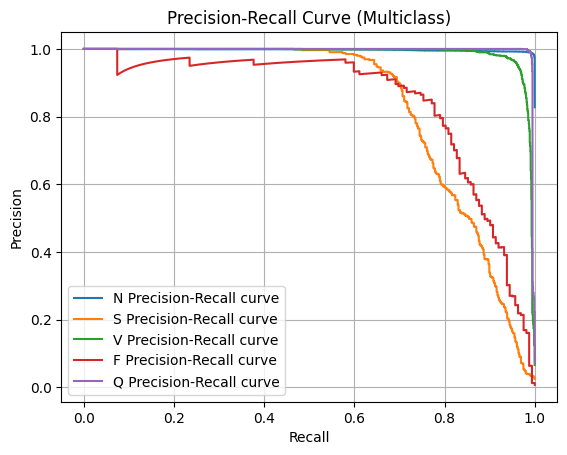

In [65]:
# 1. Precision-Recall Curve (for each class):

y_test_bin = label_binarize(y_test_np, classes=np.unique(y_test_np))  # Binarize for multiclass
precision = dict()
recall = dict()
for i in range(len(np.unique(y_test_np))):
    precision[i], recall[i], _ = precision_recall_curve(y_test_bin[:, i], ensemble_probs[:, i])
    plt.plot(recall[i], precision[i], label=f'{class_labels[i]} Precision-Recall curve') # Use class labels
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve (Multiclass)')
plt.legend()
plt.grid(True)
plt.show()

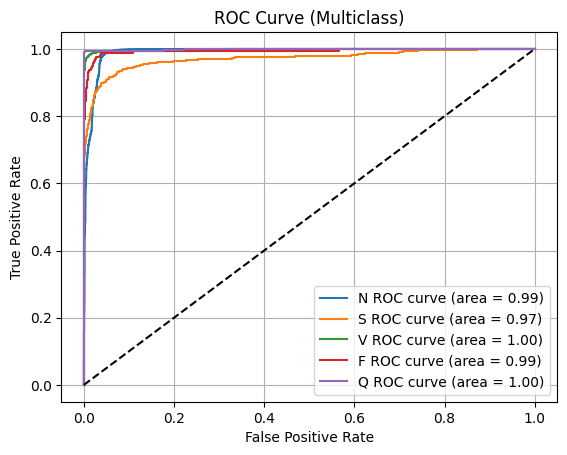

In [68]:
# 2. ROC Curve (for each class):

fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(len(np.unique(y_test_np))):
    fpr[i], tpr[i], _ = roc_curve(y_test_bin[:, i], ensemble_probs[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])
    plt.plot(fpr[i], tpr[i], label=f'{class_labels[i]} ROC curve (area = {roc_auc[i]:.2f})') # Use class labels
plt.plot([0, 1], [0, 1], 'k--')  # Dashed diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve (Multiclass)')
plt.legend()
plt.grid(True)
plt.show()

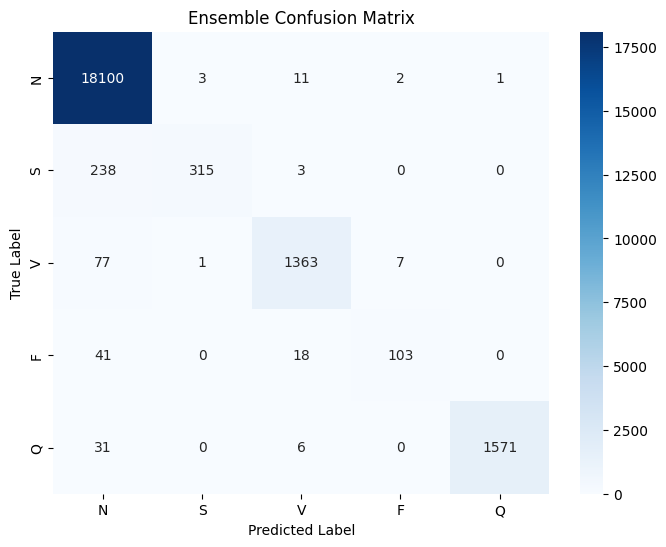

In [69]:
# 3. Confusion Matrix (with class labels):

cm = confusion_matrix(y_test_np, ensemble_predictions)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=class_labels,  # Use class labels for x-axis
            yticklabels=class_labels)  # Use class labels for y-axis
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Ensemble Confusion Matrix')
plt.show()

In [82]:
# Expanded Class Annotations (Dictionary) - EXACTLY as in the flowchart:
class_annotations = {
    0: "Normal (N)",  # Exactly "Normal (N)"
    1: "Supraventricular Premature (S)",  # Exactly "Supraventricular Premature (S)"
    2: "Ventricular Premature (V)",  # Exactly "Ventricular Premature (V)"
    3: "Fusion (F)",  # Exactly "Fusion (F)"
    4: "Unclassifiable (Q)"  # Exactly "Unclassifiable (Q)"
}

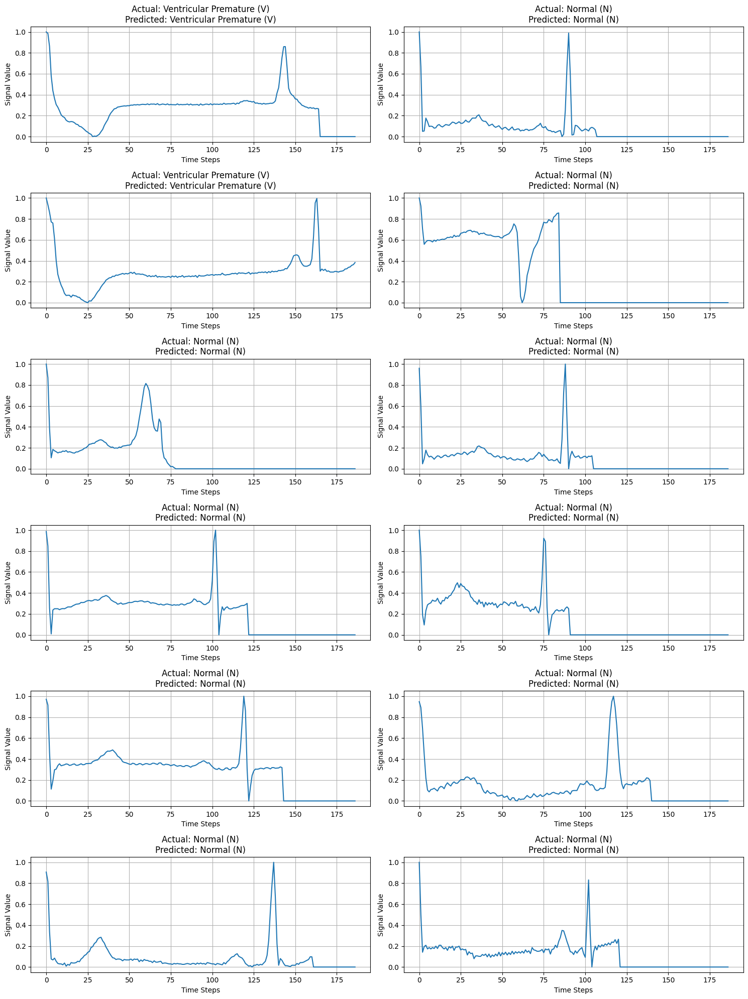

In [85]:
num_samples_to_plot = 12
sample_indices = np.random.choice(len(X_test_scaled), size=num_samples_to_plot, replace=False)

X_samples = X_test_scaled[sample_indices].cpu().numpy()
y_true_samples = y_test_np[sample_indices]
y_pred_samples = ensemble_predictions[sample_indices]

# Reshape X_samples if it's 3D to 2D
if X_samples.ndim == 3:
    X_samples = X_samples.reshape(X_samples.shape[0], -1)

X_samples_rescaled = scaler.inverse_transform(X_samples)

nrows = 6
ncols = 2

fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15, 20))
axes = axes.flatten()

for i in range(num_samples_to_plot):
    ax = axes[i]

    ax.plot(X_samples_rescaled[i])

    # Improved Title with EXACT Class Names from Flowchart:
    true_label = class_annotations[y_true_samples[i]]
    predicted_label = class_annotations[y_pred_samples[i]]
    ax.set_title(f"Actual: {true_label}\nPredicted: {predicted_label}")

    ax.set_xlabel("Time Steps")
    ax.set_ylabel("Signal Value")
    ax.grid(True)

# Hide any unused subplots
for j in range(i + 1, nrows * ncols):
    axes[j].set_axis_off()

plt.tight_layout()
plt.show()